# Определение стоимости автомобиля
Сервис по продаже автомобилей с пробегом «Не бит, не крашен» разрабатывает приложение для привлечения новых клиентов. В нём можно быстро узнать рыночную стоимость своего автомобиля. В вашем распоряжении исторические данные: технические характеристики, комплектации и цены автомобилей. Вам нужно построить модель для определения стоимости.
Заказчику важны:

- качество предсказания;
- скорость предсказания;
- время обучения. 

## Задачи проекта
### [Загрузите и подготовьте данные.](#step1)


### [Обучите разные модели. Для каждой попробуйте различные гиперпараметры.](#step2)


### [Проанализируйте скорость работы и качество моделей.](#step3)


### [ Вывод](#step4)

# Этапы выполнения проекта
## 1. Загрузка и подготовка данных <a id='step1'></a>

In [1]:
import pandas as pd
import numpy as np
import math
import matplotlib.pyplot as plt
from scipy import stats as st
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import seaborn as sns
sns.set_style('darkgrid')
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import plotly.express as px
from sklearn import preprocessing
from plotly.figure_factory import create_distplot
import plotly.figure_factory as ff
from plotly.figure_factory import create_scatterplotmatrix
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV
import time
from sklearn.dummy import DummyRegressor


In [2]:
df = pd.read_csv('/datasets/autos.csv')


In [3]:
df

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen
0,2016-03-24 11:52:17,480,NaN,1993,manual,0,golf,150000,0,petrol,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,NaN,125000,5,gasoline,audi,yes,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,1500,small,2001,manual,75,golf,150000,6,petrol,volkswagen,no,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
354364,2016-03-21 09:50:58,0,NaN,2005,manual,0,colt,150000,7,petrol,mitsubishi,yes,2016-03-21 00:00:00,0,2694,2016-03-21 10:42:49
354365,2016-03-14 17:48:27,2200,NaN,2005,NaN,0,NaN,20000,1,NaN,sonstige_autos,NaN,2016-03-14 00:00:00,0,39576,2016-04-06 00:46:52
354366,2016-03-05 19:56:21,1199,convertible,2000,auto,101,fortwo,125000,3,petrol,smart,no,2016-03-05 00:00:00,0,26135,2016-03-11 18:17:12
354367,2016-03-19 18:57:12,9200,bus,1996,manual,102,transporter,150000,3,gasoline,volkswagen,no,2016-03-19 00:00:00,0,87439,2016-04-07 07:15:26


In [4]:
df.sample(10)

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen
280387,2016-03-07 20:51:57,600,sedan,1998,auto,179,5er,150000,11,petrol,bmw,no,2016-03-07 00:00:00,0,25767,2016-03-26 08:17:16
269391,2016-03-26 23:52:00,13600,coupe,2001,auto,0,3er,70000,0,NaN,bmw,NaN,2016-03-26 00:00:00,0,76698,2016-04-07 01:46:36
246400,2016-03-29 12:51:38,6500,small,2010,manual,69,polo,50000,6,petrol,volkswagen,no,2016-03-29 00:00:00,0,10557,2016-04-03 21:17:44
116405,2016-04-01 18:36:50,4000,other,2012,NaN,0,other,60000,0,gasoline,nissan,NaN,2016-04-01 00:00:00,0,18198,2016-04-01 18:36:50
208320,2016-03-31 02:57:36,2900,wagon,2001,manual,136,3er,150000,10,gasoline,bmw,no,2016-03-31 00:00:00,0,38162,2016-04-06 02:16:15
116446,2016-03-16 12:52:43,8700,small,2013,auto,71,fortwo,20000,4,petrol,smart,no,2016-03-16 00:00:00,0,86169,2016-04-06 07:46:42
267221,2016-03-11 18:44:33,2800,wagon,2003,manual,107,scenic,70000,3,petrol,renault,no,2016-03-11 00:00:00,0,25474,2016-03-16 06:44:54
312836,2016-03-19 16:44:29,990,NaN,2005,manual,50,polo,150000,6,NaN,volkswagen,NaN,2016-03-19 00:00:00,0,58239,2016-03-19 16:44:29
253362,2016-03-16 19:55:44,1050,wagon,1997,manual,125,NaN,150000,10,petrol,audi,NaN,2016-03-16 00:00:00,0,28357,2016-04-05 03:15:58
296469,2016-03-14 10:45:11,400,wagon,2004,manual,150,laguna,150000,4,gasoline,renault,yes,2016-03-14 00:00:00,0,88316,2016-03-15 04:46:07


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
DateCrawled          354369 non-null object
Price                354369 non-null int64
VehicleType          316879 non-null object
RegistrationYear     354369 non-null int64
Gearbox              334536 non-null object
Power                354369 non-null int64
Model                334664 non-null object
Kilometer            354369 non-null int64
RegistrationMonth    354369 non-null int64
FuelType             321474 non-null object
Brand                354369 non-null object
NotRepaired          283215 non-null object
DateCreated          354369 non-null object
NumberOfPictures     354369 non-null int64
PostalCode           354369 non-null int64
LastSeen             354369 non-null object
dtypes: int64(7), object(9)
memory usage: 43.3+ MB


In [6]:
df.describe()

,Price,RegistrationYear,Power,Kilometer,RegistrationMonth,NumberOfPictures,PostalCode
count,354369.000000,354369.000000,354369.000000,354369.000000,354369.000000,354369.0,354369.000000
mean,4416.656776,2004.234448,110.094337,128211.172535,5.714645,0.0,50508.689087
std,4514.158514,90.227958,189.850405,37905.341530,3.726421,0.0,25783.096248
min,0.000000,1000.000000,0.000000,5000.000000,0.000000,0.0,1067.000000
25%,1050.000000,1999.000000,69.000000,125000.000000,3.000000,0.0,30165.000000
50%,2700.000000,2003.000000,105.000000,150000.000000,6.000000,0.0,49413.000000
75%,6400.000000,2008.000000,143.000000,150000.000000,9.000000,0.0,71083.000000
max,20000.000000,9999.000000,20000.000000,150000.000000,12.000000,0.0,99998.000000


In [7]:
print('Количество дубликатов:',df.duplicated().value_counts())

Количество дубликатов: False    354365
True          4
dtype: int64


In [8]:
df =  df.drop_duplicates().reset_index(drop=True)

In [9]:
idx = df.index[df.isnull().all(1)]
nans = df.loc[idx]
print('Количество пустых строк:', len(nans))

Количество пустых строк: 0


Найдем процент заполненных данных в  столбцах. 

In [10]:
res_info = []
for column in df.columns:
    res_info.append(df[column].count()/df.shape[0]*100)
filling_df = pd.Series(res_info, index = df.columns) 
filling_df

DateCrawled          100.000000
Price                100.000000
VehicleType           89.420513
RegistrationYear     100.000000
Gearbox               94.403228
Power                100.000000
Model                 94.439349
Kilometer            100.000000
RegistrationMonth    100.000000
FuelType              90.717198
Brand                100.000000
NotRepaired           79.920703
DateCreated          100.000000
NumberOfPictures     100.000000
PostalCode           100.000000
LastSeen             100.000000
dtype: float64

#### Краткий вывод
- были обнаружены 4 дубликата и удалены
- больше всего пропусков обнаружено в столбце NotRepaired. Их заполним 0, так как вероятнее всего их просто не заполняли на этапе сбора информации. Далее проведем кодировку значений - no заменим на 0, yes - на 1.
- пропуски в категориальных столбцах вероятнее всего никак не заполнить на основе текущих данных. Поэтому можно заполнить значением unknown.
- в некоторых столбцах минимальное значение равно нулю, например, стоимость, мощность и месяц регистрации. Скорей всего надо удалить нули у целевого признака, так как они не несут никакой дальнейшей пользы. Пропуски в мощности можно заполнить средним значением в зависимости от марки, модели и типа топлива. 
- в годе выпуска имеются выбросы данных
- необходимо выполнить кодирование категориальных столбцов


### Обработка данных
#### Столбец NotRepaired

Согласно плану, заполняем пропуски нулями и преобразуем столбец в булев тип. 

In [11]:
df_copy = df.copy()
df_copy['NotRepaired'] = df_copy['NotRepaired'].fillna('no')
df_copy['NotRepaired'] = df_copy['NotRepaired'].map({'yes': 1, 'no': 0})

#### Столбец Price

Рассмотрим распределение стоимости автомобилей. 

In [12]:
fig = px.histogram(df_copy, x='Price')
fig.show()

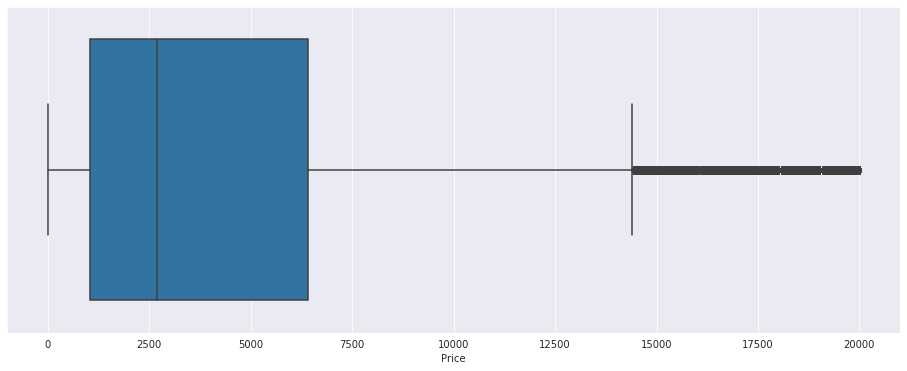

In [13]:
plt.figure(figsize=(16, 6))
sns.boxplot(x=df_copy['Price']);

На графиках видно, что есть автомобили стоимостью от 0 до 100 евро. Также имеются выбросы в стоимости (от 14600). Удалим их. 

In [14]:
df_copy = df_copy[(df_copy['Price']>100)]
df_copy = df_copy[(df_copy['Price']<=14600)]

In [15]:
df_copy['Price'].describe()

count    322368.000000
mean       3920.133434
std        3519.736859
min         101.000000
25%        1199.000000
50%        2690.000000
75%        5800.000000
max       14600.000000
Name: Price, dtype: float64

#### Столбец Power  

Как видно на графиках ниже, 34 тысячи автомобилей имеют 0 мощность. Заполним их медианой в зависимости от марки, модели и типа топлива. Также видны выбросы, которые все реже встречаются для автомобилей от 2500 лошадиных сил. Воспользуемся этой границей. 

In [16]:
df_copy['Power'].describe()

count    322368.000000
mean        107.869624
std         189.830467
min           0.000000
25%          69.000000
50%         102.000000
75%         140.000000
max       20000.000000
Name: Power, dtype: float64

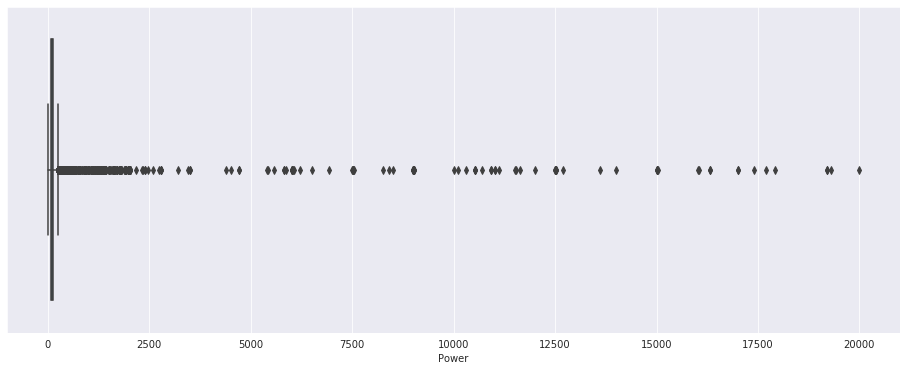

In [17]:
plt.figure(figsize=(16, 6))
sns.boxplot(x=df_copy['Power']);

In [18]:
fig = px.histogram(df_copy, x='Power')
fig.show()

In [19]:
df_copy['Power'] = df_copy['Power'].replace(0, np.nan)
df_copy['Power'] = df_copy['Power'].fillna(df_copy.groupby(['Brand', 'Model', 'FuelType'])['Power'].transform('median'))

In [20]:
df_copy = df_copy[(df_copy['Power']<=2500)]

#### Столбец RegistrationYear   

Оставим границы автомобилей, расположенных в диапазоне от 1950 до 2019 года.

In [21]:
fig = px.histogram(df_copy, x='RegistrationYear')
fig.show()

In [22]:
df_copy = df_copy[(df_copy['RegistrationYear']>=1950)]
df_copy = df_copy[(df_copy['RegistrationYear']<=2019)]

#### Столбец RegistrationMonth

Заполним нулевые значения медианой. 

In [23]:
df_copy['RegistrationMonth'] = df_copy['RegistrationMonth'].replace(0, df_copy['RegistrationMonth'].median())

In [24]:
df_copy['RegistrationMonth'].describe()

count    311323.000000
mean          6.364335
std           3.215045
min           1.000000
25%           4.000000
50%           6.000000
75%           9.000000
max          12.000000
Name: RegistrationMonth, dtype: float64

#### Прочие категориальные столбцы

Как и планировалось, пропуски в таких столбцах заполним переменной unknown.

In [25]:
df_copy = df_copy.fillna('unknown')
df_copy = df_copy.reset_index(drop=True)

In [26]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 311323 entries, 0 to 311322
Data columns (total 16 columns):
DateCrawled          311323 non-null object
Price                311323 non-null int64
VehicleType          311323 non-null object
RegistrationYear     311323 non-null int64
Gearbox              311323 non-null object
Power                311323 non-null float64
Model                311323 non-null object
Kilometer            311323 non-null int64
RegistrationMonth    311323 non-null int64
FuelType             311323 non-null object
Brand                311323 non-null object
NotRepaired          311323 non-null int64
DateCreated          311323 non-null object
NumberOfPictures     311323 non-null int64
PostalCode           311323 non-null int64
LastSeen             311323 non-null object
dtypes: float64(1), int64(7), object(8)
memory usage: 38.0+ MB


## Создание датасета для обучения

Отберем необходимые столбцы для обучения, проведем кодирование признаков с помощью библиотеки LabelEncoder. Использовать дамми классификатор нет смысла из-за генерации большого количества столбцов.

In [27]:
category_columns = ['VehicleType', 'Gearbox', 'Model', 'FuelType', 'Brand']
delete_columns =['DateCrawled','DateCreated','PostalCode','NumberOfPictures','LastSeen']

In [28]:
df_copy = df_copy.drop(delete_columns, axis=1)

In [29]:
def encoder(df, columns):
    for column in columns:
        le = preprocessing.LabelEncoder()
        le.fit(df[column])
        df[column + '_le'] = le.transform(df[column])
    return df

In [30]:
df_encode = encoder(df_copy, category_columns)

In [31]:
df_encode= df_copy.drop(category_columns, axis=1)

In [32]:
df_encode

,Price,RegistrationYear,Power,Kilometer,RegistrationMonth,NotRepaired,VehicleType_le,Gearbox_le,Model_le,FuelType_le,Brand_le
0,480,1993,90.0,150000,6,0,7,1,116,6,38
1,9800,2004,163.0,125000,8,0,6,0,117,2,14
2,1500,2001,75.0,150000,6,0,5,1,116,6,38
3,3600,2008,69.0,90000,7,0,5,1,101,2,31
4,650,1995,102.0,150000,10,1,4,1,11,6,2
...,...,...,...,...,...,...,...,...,...,...,...
311318,3200,2004,225.0,150000,5,1,4,1,140,6,30
311319,1150,2000,125.0,150000,3,0,0,1,249,6,24
311320,1199,2000,101.0,125000,3,0,1,0,106,6,32
311321,9200,1996,102.0,150000,3,0,0,1,223,2,38


Построим матрицу корреляций.

In [33]:
corrs = df_encode.corr()
fig= ff.create_annotated_heatmap(
    z=corrs.values,
    x=list(corrs.columns),
    y=list(corrs.index),
    annotation_text=corrs.round(2).values,
    showscale=True)
fig.show()


<p>Как видно, на стоимость больше всего влияет мощность и год регистрации. </p>
<p>Переходим к следующему этапу.</p>


### Шаг 2. Обучите разные модели. Для каждой попробуйте различные гиперпараметры.<a id='step2'></a>

<p>Для обучения будем использовать следующие модели: DecisionTreeRegressor, RandomForestRegressor, LightBLM, CatBoostRegressor. На данном этапе будем использовать стандартные гиперпараметры у моделей. Масштабировать данные заведомо не будем.</p>
<p>Для начала разобъем нашу выборку на обучающую, валидационную и тестовую. Проверим, что количество элементов в соотношении 3:1:1 и оно равно кол-ву элеметов в исходной выборке. </p>

In [34]:
test = df_encode.sample(frac=0.2,random_state=42).copy()
train_full = df_encode[~df_encode.index.isin(test.index)].copy()
validate = train_full.sample(frac=0.25,random_state=42).copy()
train = train_full[~train_full.index.isin(validate.index)].copy()

features_train = train.drop(['Price'], axis=1)
target_train = train['Price']
test_features = test.drop(['Price'], axis=1)
test_target = test['Price']
features_valid = validate.drop(['Price'], axis=1)
target_valid = validate['Price']

In [35]:
print('Обучающая выборка:',train.shape[0])
print('Валидационная выборка',validate.shape[0])
print('Тестовая выборка:',test.shape[0])
print('Исходная выборка:',df_encode.shape[0])
print('Сумма выборок:',train.shape[0]+validate.shape[0]+test.shape[0])


Обучающая выборка: 186794
Валидационная выборка 62264
Тестовая выборка: 62265
Исходная выборка: 311323
Сумма выборок: 311323


Подготовим функцию для вычисления времени и ее применения для моделей обучения. 

In [36]:
def exec_time(start, end):
    diff_time = end - start 
    return diff_time 

In [37]:
res = []

In [38]:
def model(model_name):
    start = time.time()
    model = model_name
    model.fit(features_train,target_train) 
    end = time.time()
    fit_time = exec_time(start, end)
    
    start = time.time()
    predicted_valid = model.predict(features_valid)
    end = time.time()
    predict_time = exec_time(start, end)
    
    print('Среднее прогнозируемое =',predicted_valid.mean())
    print('Среднее фактическое =',target_valid.mean())
    print('RMSE =',mean_squared_error(target_valid, predicted_valid)**0.5)
    
    res.append({'Модель': model, 
                'Время обучения': fit_time, 
                'Скорость предсказания': predict_time, 
                'Среднее фактическое': target_valid.mean(), 
                'Среднее прогнозируемое': predicted_valid.mean(), 
                'RMSE': mean_squared_error(target_valid, predicted_valid)**0.5})
    return res

#### LinearRegression

In [39]:
model_lr = model(LinearRegression())

Среднее прогнозируемое = 3994.146781613018
Среднее фактическое = 3992.870647565206
RMSE = 2601.9311906383964


#### DecisionTreeRegressor

In [40]:
model_dtr = model(DecisionTreeRegressor(random_state=12345))

Среднее прогнозируемое = 3998.568404531705
Среднее фактическое = 3992.870647565206
RMSE = 1752.4428662086302


#### RandomForestRegressor

In [41]:
model_rfr = model(RandomForestRegressor(n_estimators=100, random_state=12345))

Среднее прогнозируемое = 4014.049580902514
Среднее фактическое = 3992.870647565206
RMSE = 1371.1458695091799


#### LightBLM

In [42]:
model_LightBLM = model(LGBMRegressor(random_state=12345))

Среднее прогнозируемое = 3994.3011781280366
Среднее фактическое = 3992.870647565206
RMSE = 1445.1329753416608


#### CatBoostRegressor

In [43]:
model_cbr = model(CatBoostRegressor(random_state=12345))

0:	learn: 3465.9456037	total: 120ms	remaining: 2m
1:	learn: 3401.1160907	total: 305ms	remaining: 2m 32s
2:	learn: 3342.0375198	total: 498ms	remaining: 2m 45s
3:	learn: 3282.1464420	total: 608ms	remaining: 2m 31s
4:	learn: 3226.2322631	total: 800ms	remaining: 2m 39s
5:	learn: 3173.7746495	total: 918ms	remaining: 2m 32s
6:	learn: 3120.1256917	total: 1.11s	remaining: 2m 37s
7:	learn: 3072.3375934	total: 1.29s	remaining: 2m 40s
8:	learn: 3023.0721029	total: 1.41s	remaining: 2m 35s
9:	learn: 2977.9821293	total: 1.62s	remaining: 2m 40s
10:	learn: 2932.0902135	total: 1.79s	remaining: 2m 41s
11:	learn: 2887.8979459	total: 1.91s	remaining: 2m 37s
12:	learn: 2847.7456576	total: 2.09s	remaining: 2m 38s
13:	learn: 2809.2933292	total: 2.21s	remaining: 2m 35s
14:	learn: 2770.2862888	total: 2.39s	remaining: 2m 37s
15:	learn: 2732.8524186	total: 2.51s	remaining: 2m 34s
16:	learn: 2698.9692203	total: 2.7s	remaining: 2m 35s
17:	learn: 2664.4430083	total: 2.89s	remaining: 2m 37s
18:	learn: 2630.4697735	t

## Анализ скорости и качества <a id='step3'></a>

In [44]:
res = pd.DataFrame(res)
res['Модель']=['LinearRegression','DecisionTreeRegressor','RandomForestRegressor','LGBMRegressor','CatBoostRegressor']

In [45]:
res.style.highlight_min(color = 'lightgreen', axis = 0)

,Модель,Время обучения,Скорость предсказания,Среднее фактическое,Среднее прогнозируемое,RMSE
0,LinearRegression,0.0790937,0.0501373,3992.87,3994.15,2601.93
1,DecisionTreeRegressor,1.38929,0.0493367,3992.87,3998.57,1752.44
2,RandomForestRegressor,82.8679,3.53399,3992.87,4014.05,1371.15
3,LGBMRegressor,53.6294,0.800294,3992.87,3994.3,1445.13
4,CatBoostRegressor,159.693,0.0980723,3992.87,3995.68,1436.3


<p>Модели RandomForestRegressor и LGBMRegressor обладают наилучшим соотношением качества, времени обучения и скорости предсказания. Попробуем изменить параметры у моделей, чтобы улучшить данные показатели.</p>
<p>P.S. Врем выполнения очень долгое. Если ядро упадет, то пропустите этот шаг.</p>


### Изменение параметров у моделей

#### LGBMRegressor

In [46]:
num_leaves = [31,35]
n_estimators = [100,300,500]
results = []
for i in num_leaves:
    for x in n_estimators:
        model = LGBMRegressor(random_state = 12345, n_estimators = x, num_leaves = i)
        start = time.time()
        model.fit(features_train,target_train)
        end = time.time()
        fit_time = exec_time(start, end)
        
        start = time.time()
        predicted_valid = model.predict(features_valid)
        end = time.time()
        predict_time = exec_time(start, end)
        
        results.append({'Модель': 'LGBMRegressor', 
                'Число листьев': i, 
                'Число деревьев в лесу': x, 
                'Время обучения': fit_time,                         
                'Скорость предсказания': predict_time, 
                'Среднее фактическое': target_valid.mean(), 
                'Среднее прогнозируемое': predicted_valid.mean(), 
                'RMSE': mean_squared_error(target_valid, predicted_valid)**0.5})

        
        
        

#### RandomForestRegressor

In [47]:
min_samples_leaf = [1]
n_estimators = [100,120]
for i in min_samples_leaf:
    for x in n_estimators:
        model = RandomForestRegressor(random_state = 12345, n_estimators = x, min_samples_leaf = i)
        start = time.time()
        model.fit(features_train,target_train)
        end = time.time()
        fit_time = exec_time(start, end)
        
        start = time.time()
        predicted_valid = model.predict(features_valid)
        end = time.time()
        predict_time = exec_time(start, end)
        
        results.append({'Модель': 'RandomForestRegressor', 
                'Минимальное число экземпляров в листовом узле': i, 
                'Число деревьев в лесу': x, 
                'Время обучения': fit_time,                         
                'Скорость предсказания': predict_time, 
                'Среднее фактическое': target_valid.mean(), 
                'Среднее прогнозируемое': predicted_valid.mean(), 
                'RMSE': mean_squared_error(target_valid, predicted_valid)**0.5})

In [48]:
results = pd.DataFrame(results)
results
results.style.highlight_min(color = 'lightgreen', axis = 0)

,Модель,Число листьев,Число деревьев в лесу,Время обучения,Скорость предсказания,Среднее фактическое,Среднее прогнозируемое,RMSE,Минимальное число экземпляров в листовом узле
0,LGBMRegressor,31,100,142.979,0.726964,3992.87,3994.3,1445.13,nan
1,LGBMRegressor,31,300,30.8696,2.11311,3992.87,3993.64,1376.39,nan
2,LGBMRegressor,31,500,30.3897,3.44579,3992.87,3993.31,1354.59,nan
3,LGBMRegressor,35,100,20.5102,0.795228,3992.87,3994.91,1434.98,nan
4,LGBMRegressor,35,300,25.4962,2.12676,3992.87,3994.12,1371.09,nan
5,LGBMRegressor,35,500,44.6675,3.41242,3992.87,3993.1,1350.67,nan
6,RandomForestRegressor,nan,100,75.8079,3.43209,3992.87,4014.05,1371.15,1
7,RandomForestRegressor,nan,120,99.1271,4.11312,3992.87,4013.81,1369.77,1


Результат изменений гиперпараметров: наилучший показатель RMSE (1350.67) достигается у алгоритма LGBMRegressor при количестве деревьев 50. Время на обучения и скорость предсказания лучше, чем у RandomForestRegressor. Поэтому я бы предпочел выбрать модель LGBMRegressor с 500 деревьев в лесу, и число листьев 35.
Прочие параметры не рассматривал, так как модели очень долго обучаются. Рассмотрим качество модели на тестовой выборке. 

#### Тестирование финальной выборки

In [49]:
test_results = []
model = LGBMRegressor(random_state = 12345, n_estimators = 500, num_leaves = 35)
start = time.time()
model.fit(features_train,target_train)
end = time.time()
fit_time = exec_time(start, end)
        
start = time.time()
predicted_test = model.predict(test_features)
end = time.time()
predict_time = exec_time(start, end)

test_results.append({'Модель': 'LGBMRegressor', 
                'Число деревьев в лесу': 500, 
                'Число листьев': 35, 
                'Время обучения': fit_time,                         
                'Скорость предсказания': predict_time, 
                'Среднее фактическое': test_target.mean(), 
                'Среднее прогнозируемое': predicted_test.mean(), 
                'RMSE': mean_squared_error(test_target, predicted_test)**0.5})

In [50]:
test_results = pd.DataFrame(test_results)
test_results

,Модель,Число деревьев в лесу,Число листьев,Время обучения,Скорость предсказания,Среднее фактическое,Среднее прогнозируемое,RMSE
0,LGBMRegressor,500,35,207.066972,3.597249,3980.643877,3986.898185,1351.883806


Как видно, показатель RMSE немного уменьшился на тестовой выборке. 

#### Проверка на адекватность.

In [51]:
dummy_regr = DummyRegressor(strategy='mean')

dummy_regr.fit(features_train,target_train)
dummy_predict = dummy_regr.predict(test_features)
print('RMSE', mean_squared_error(test_target, dummy_predict)**0.5)

RMSE 3527.1988561137928


Показатель RMSE у Dummy более чем в два раза больше, чем LGBMRegressor. Это означает, что наша модель далека от случайной и ее можно считать рабочей.

### Вывод<a id='step4'></a>

На этапе обработки и анализа данных мы обнаружили:
<ul>
<li>большое количество пропусков в данных. Необходимо разобраться откуда они появляются и по возможности устранить ошибку.</li>
<li>выбросы в данных. Они были удалены для корректной работы алгоритма.</li>
    </ul>

В датасете имелось большое количество категориальных данных, которые были заменены простым кодированием на числовые значения с помощью LabelEncoder(). Прямое кодирование не использовалось из-за появления большого количества столбцов. 
Финальный датасет мы испытывали на следующих моделях: LinearRegression, DecisionTreeRegressor, RandomForestRegressor, LightBLM, CatBoostRegressor. Наилучший совокупный показатель скорости и качества достигается у модели LGBMRegressor, поэтому мы предлагаем использовать данный алгоритм для предсказания стоимости автомобиля. Проверку на адекватность данная модель прошла успешно. 